In [1]:
!pip install soundfile
!pip install pydub
!pip install torchmetrics

     |████████████████████████████████| 398 kB 4.0 MB/s 


In [2]:
import numpy as np
import torch
import torch.nn as nn
from pathlib import Path
import librosa
import os
import pandas as pd
import librosa.display
import IPython.display as ipd
from sklearn.model_selection import train_test_split
import soundfile as sf
from pydub import AudioSegment
import random
%matplotlib inline
import torch
from sklearn.preprocessing import LabelEncoder
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
from torchvision import datasets
from torchvision.transforms import ToTensor
import torch.nn.functional as F
import matplotlib.pyplot as plt
import torchvision
import torchvision.transforms as transforms
import torchmetrics
import re

In [3]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


## Explanation
### Synthetic dataset:
The first Mel_CNN model works well on synthetic dataset which is consist of 135 tracks (15 samples of each tempo 80,90,100,110,115,120,125,130,135) mostly drums to have a clear beat. If a track is less than 10seconds, repeat it so that the model will be trained on same size inputs. These 9 tempos are the labels for the AIST++ dataset. First the model got overfit on 50 samples of data, then trained on whole 135 samples. Data Augmentation on train set (choose some random samples and pitch scaling 2 semitones up or down) improves the result for this dataset.

### AIST++ dataset:
This dataset consit of 60 samples of music with 9 labels for bpm. Because I trained the synthetic data on 10 seconds of songs, for the first attempt, I chose the first 10 seconds of each track in AIST++ dataset and train the Mel_CNN model on that which had a good result on this chunk. Then I went for choosing 10 seconds of each track but not just the first 10 second, an arbitrary 10 second in each track. In this case, although the model was trained but it was not generalized and it got overfit (after an epoch test loss started to increase and training loss was near to 0). In both of these cases the model was trained on 48 samples and it was tested on 12 samples.<br> 
For another case, after spliting the dataset to train and test sets, I chose all the 10 seconds which was existed on on song for training set (so if all the samples in training set are 20 seconds the split is 0-10 and 10-20 and the number of input is gonna double), and for test part again I went for an arbitrary 10 second in each track in test set. Again the model was trained but got overfit and could not capture and predict the test set.<br>
In the AIST++ dataset, there are 3 tempos each of which only has one track. I drop the less frequent samples and train the model on 57 samples but this time with 6labels. And again the model got overfit. <br>
Because the model is training and it has a good result on train set, it shows that the model and the data is correct. For the overfitting problem I changed the probability of dropout and increase it and the best result was for 0.5 or 0.4. I also tried different learning rate to decrease the speed of training in some cases but if it is very low the model stops training. The only thing I could thought of is that either my model is too complex for the dataset to it is just learning the training part or the number of samples is too low for this prediction (which definitely is!). So now I can go for a simpler model or use another dataset that has more samples to see if the result will improve or not. <br>
For the simpler model I went for hMel_CNN. In this case, the model learned very very fast in just 3-5 epochs. But for the cases that were overfit, there was no improvement.

### Music dataset:
This dataset consist of 698 samples of ballroom dataset. Because this dataset has more samples than AIST++, it was expected that it can generalize better. I trained 3 model on this dataset, one model is a part of TCN model and I just took the convolution part of it and add 1 linear layer for prediction, the same architecture as Mel_CNN, and a feedforward network. It turn out that the feedforward model is not suitable for this task. The TCN_CNN and Mel_CNN could not generalize the model as expected! <br>
According to the papers working on ballroom dataset, TCN and BLSTM are 2 models that worked for beat detection.

##Functions

In [4]:
FRAME_SIZE = 1024
HOP_SIZE = 512
sr = 22050


def extract_spectogram(Y, sr, frame_size,hop_length):
  S_scale = librosa.stft(Y, n_fft=frame_size, hop_length=hop_length)
  Y_scale = np.abs(S_scale) ** 2
  Y_log_scale = librosa.power_to_db(Y_scale)

  return Y_log_scale



def plot_spectogram(Y, sr, frame_size,hop_length, y_axis):
  # plt.figure(figsize=(25, 10))
  librosa.display.specshow(Y, 
                             sr=sr, 
                             hop_length=hop_length, 
                             x_axis="time", 
                             y_axis=y_axis
                           ,cmap='gray_r'
                           )
  plt.colorbar(format="%+2.f")


def extract_mel_spectogram(Y, sr, frame_size,hop_length):
  mel_spectrogram = librosa.feature.melspectrogram(Y, sr=sr, n_fft=frame_size, hop_length=hop_length, n_mels=40)
  log_mel_spectrogram = librosa.power_to_db(mel_spectrogram)

  return log_mel_spectrogram




def extract_cqt_spectogram(Y, sr, frame_size,hop_length):
  cqt_spectrogram = librosa.cqt(Y, sr=sr,n_bins=40)
  log_cqt_spectrogram = librosa.power_to_db(cqt_spectrogram)

  return log_cqt_spectrogram


## CNN Model for Mel Spectogram

In [5]:
class Mel_CNN(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d( 1, 32 , (3, 5))
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(32, 32, (5, 3))
        self.pool = nn.MaxPool2d(2, 2)
        self.conv3 = nn.Conv2d(32, 32, (3, 3))
        self.pool = nn.MaxPool2d(2, 2)
       
        self.fc1 = nn.Linear(3264, 256)
        self.fc2 = nn.Linear(256, 128)
        self.fc3 = nn.Linear(128, 64)
        self.fc4 = nn.Linear(64, 9)
        self.dropout = nn.Dropout(p=0.4)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = self.pool(F.relu(self.conv3(x)))

        x = torch.flatten(x, 1) # flatten all dimensions except batch

        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        x = F.relu(self.fc2(x))
        x = self.dropout(x)
        x = F.relu(self.fc3(x))
        x = self.dropout(x)
        x = self.fc4(x)
        return x

In [6]:
def train_one_epoch(model, data_loader, loss_fn, opt):
  accuracy = []
  for inputs, targets in data_loader:
    inputs, targets = inputs, targets
    
    # calculate gradient
    predictions = model(inputs)
    loss = loss_fn(predictions, targets)

    # backpropagation and update weights
    opt.zero_grad()
    loss.backward() #backpropagation
    opt.step() #updating parameters
    acc = torchmetrics.functional.accuracy(predictions, targets)
    accuracy.append(acc.item())



  print("Train Loss for current epoch", "{:.5f}".format(loss.item()))
  print("Train Accuracy for current epoch",  "{:.2f}".format(sum(accuracy)/len(accuracy)))
  return loss.item(), sum(accuracy)/len(accuracy)
 



def train(model, data_loader_train, data_loader_test, loss_fn, opt, epochs):
  train_loss = []
  test_loss = []
  train_acc = []
  test_acc = []
  for i in range(epochs):
    print("Epoch", i+1)
    model.train()
    l,a, = train_one_epoch(model, data_loader_train, loss_fn, opt)
    train_loss.append(l)
    train_acc.append(a)


    model.eval()
    with torch.no_grad():

      for inputs, targets in data_loader_test:
        inputs, targets = inputs, targets
        
        predictions = model(inputs)
        loss = loss_fn(predictions, targets)
        acc = torchmetrics.functional.accuracy(predictions, targets)

        test_loss.append(loss.item())
        test_acc.append(acc.item())
        print("Test Loss for current epoch", "{:.5f}".format(loss.item()))
        print("Test Accuracy for current epoch",  "{:.2f}".format(acc.item()))



  print('training is done!')



  return train_loss, test_loss, train_acc, test_acc

In [7]:
def plot_loss_accuracy(train_loss, test_loss, train_acc, test_acc, epoch):
  plt.figure(figsize=(15,5))
  plt.subplot(121)
  plt.plot(np.arange(1,epoch+1),train_loss)
  plt.plot(np.arange(1,epoch+1),test_loss)
  plt.legend(['Train', 'Test'])
  plt.xlabel("Epoch")
  plt.ylabel("Loss")

  plt.subplot(122)
  plt.plot(np.arange(1,epoch+1),train_acc)
  plt.plot(np.arange(1,epoch+1),test_acc)
  plt.legend(['Train', 'Test'])
  plt.xlabel("Epoch")
  plt.ylabel("Accuracy")
  plt.show()


In [8]:
def prepare_data(input, target):
  le = LabelEncoder()
  target = le.fit_transform(target)
  input = input.reshape(input.shape[0],1,input.shape[1],input.shape[2])

  X_train, X_test, y_train, y_test = train_test_split(input,target, test_size = 0.2)
  
  b = X_test.shape[0]
  tensor_x = torch.Tensor(X_train) # transform to torch tensor
  tensor_y = torch.Tensor(y_train)
  tensor_y = torch.Tensor.long(tensor_y)
  my_train_dataset = TensorDataset(tensor_x,tensor_y)
  my_train_dataloader = DataLoader(my_train_dataset)

  tensor_x = torch.Tensor(X_test) # transform to torch tensor
  tensor_y = torch.Tensor(y_test)
  tensor_y = torch.Tensor.long(tensor_y)
  my_test_dataset = TensorDataset(tensor_x,tensor_y)
  my_test_dataloader = DataLoader(my_test_dataset,batch_size = b)

  return my_train_dataloader, my_test_dataloader

In [9]:
class hMel_CNN(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d( 1, 32 , (5, 5))
        self.conv2 = nn.Conv2d(32, 32, (3, 3))
        self.pool = nn.MaxPool2d(1, 2)
       
        self.fc1 = nn.Linear(108544, 256)
        self.fc2 = nn.Linear(256, 9)
        self.dropout = nn.Dropout(p=0.5)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = F.relu(self.conv2(x))
     

        x = torch.flatten(x, 1) # flatten all dimensions except batch

        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        x = self.fc2(x)
        return x

##Synthetic Dataset

The synthetic dataset has 135 tracks of some instruments (mostly drums) with their exact bpm. The first digits of each file name has the corresponding bpm for that piece. If a track is less than 10 second, we just repeat it and pick the first 10 second so that we can train the model on 10 seconds of songs. Then we extract log and mel spectogram and train the CNN on them.

In [ ]:
curr_dir = '/content/drive/MyDrive/Colab Notebooks/ML Course Project/check/'
%cd "$curr_dir"

/content/drive/MyDrive/Colab Notebooks/ML Course Project/check


In [ ]:
# original signals file name

signals = []
for path, subdirs,files in os.walk(curr_dir):
    for file in files:
        signals.append((os.path.join(file)))

In [ ]:
len(signals)

135

In [ ]:
#if a track is less than 10 seconds, repeat it 

for i in range(len(signals)):
  y = AudioSegment.from_file( curr_dir+ signals[i])
  yy,sr = librosa.load(curr_dir+ signals[i])
  d = librosa.get_duration(y=yy, sr=sr)
  combined = y
  if d<10:
    if d == 0:
      print(signals[i])
    else:
      combined = combined * int(10/d + 1)
  combined.export("/content/drive/MyDrive/Colab Notebooks/ML Course Project/check 10 sec/"+ signals[i]+str(i)+".wav", format='wav')

In [10]:
curr_dir = '/content/drive/MyDrive/Colab Notebooks/ML Course Project/check 10 sec/'
%cd "$curr_dir"

/content/drive/MyDrive/Colab Notebooks/ML Course Project/check 10 sec


In [11]:
#read the 10-second signals

signals_10 = []
for path, subdirs,files in os.walk(curr_dir):
    for file in files:
        signals_10.append((os.path.join(file)))


ipd.Audio(signals_10[0])

In [12]:
#the first digits of the file name is the tempo for that track
# using regex to extract them

syn_tempo = []
for trk in signals_10:
  myString = trk
  old = re.findall('[0-9]+_', myString)  #find one or more digits followed by a slash.
  temp = old[0].replace("_","")
  syn_tempo.append(temp)

In [13]:
#extract the librosa signal file for the 10-second tracks
syn_signal = []
for trk in signals_10:
  yy,sr = librosa.load(trk, duration=10)
  syn_signal.append(yy)

Extract mel spectogram for synthetic data

In [14]:
syn_mel = []
for i in range(len(syn_signal)):
  temp = extract_mel_spectogram(syn_signal[i], 22050, 1024,512)
  syn_mel.append(temp)

syn_mel = np.array(syn_mel)

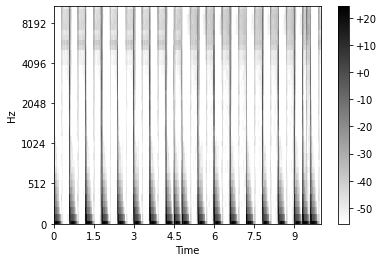

In [15]:
plot_spectogram(syn_mel[5], sr, FRAME_SIZE,HOP_SIZE,'mel')


Train the model

Overfit on 50 samples

Epoch 1
Train Loss for current epoch 2.05780
Train Accuracy for current epoch 0.15
Test Loss for current epoch 1.93432
Test Accuracy for current epoch 0.30
Epoch 2
Train Loss for current epoch 2.08150
Train Accuracy for current epoch 0.33
Test Loss for current epoch 1.74551
Test Accuracy for current epoch 0.30
Epoch 3
Train Loss for current epoch 1.77914
Train Accuracy for current epoch 0.30
Test Loss for current epoch 1.71092
Test Accuracy for current epoch 0.30
Epoch 4
Train Loss for current epoch 2.36733
Train Accuracy for current epoch 0.35
Test Loss for current epoch 1.51807
Test Accuracy for current epoch 0.40
Epoch 5
Train Loss for current epoch 1.10008
Train Accuracy for current epoch 0.30
Test Loss for current epoch 1.46886
Test Accuracy for current epoch 0.40
Epoch 6
Train Loss for current epoch 1.74939
Train Accuracy for current epoch 0.47
Test Loss for current epoch 1.37129
Test Accuracy for current epoch 0.40
Epoch 7
Train Loss for current epoch 0.63078
Train Accuracy for 

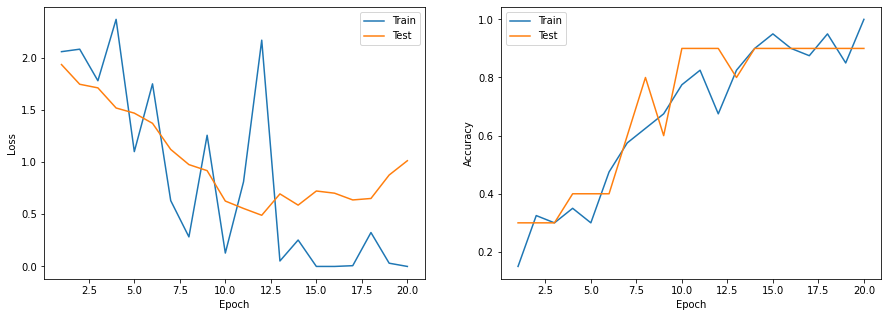

In [27]:
epoch = 20
syn_model = Mel_CNN()
loss_fn = nn.CrossEntropyLoss()
syn_optimizer = torch.optim.Adam(syn_model.parameters(),   lr = 0.0001)
train_dataloader, test_dataloader = prepare_data(syn_mel[:50],syn_tempo[:50])
train_loss, test_loss, train_acc, test_acc= train(syn_model, train_dataloader, test_dataloader, loss_fn, syn_optimizer, epoch)
plot_loss_accuracy(train_loss, test_loss, train_acc, test_acc, epoch)

Epoch 1
Train Loss for current epoch 2.18440
Train Accuracy for current epoch 0.09
Test Loss for current epoch 2.20427
Test Accuracy for current epoch 0.00
Epoch 2
Train Loss for current epoch 2.40615
Train Accuracy for current epoch 0.09
Test Loss for current epoch 2.20621
Test Accuracy for current epoch 0.00
Epoch 3
Train Loss for current epoch 2.23286
Train Accuracy for current epoch 0.19
Test Loss for current epoch 2.16263
Test Accuracy for current epoch 0.11
Epoch 4
Train Loss for current epoch 2.33152
Train Accuracy for current epoch 0.18
Test Loss for current epoch 1.99857
Test Accuracy for current epoch 0.30
Epoch 5
Train Loss for current epoch 2.35893
Train Accuracy for current epoch 0.34
Test Loss for current epoch 1.69934
Test Accuracy for current epoch 0.41
Epoch 6
Train Loss for current epoch 2.17016
Train Accuracy for current epoch 0.45
Test Loss for current epoch 1.44458
Test Accuracy for current epoch 0.56
Epoch 7
Train Loss for current epoch 2.05567
Train Accuracy for 

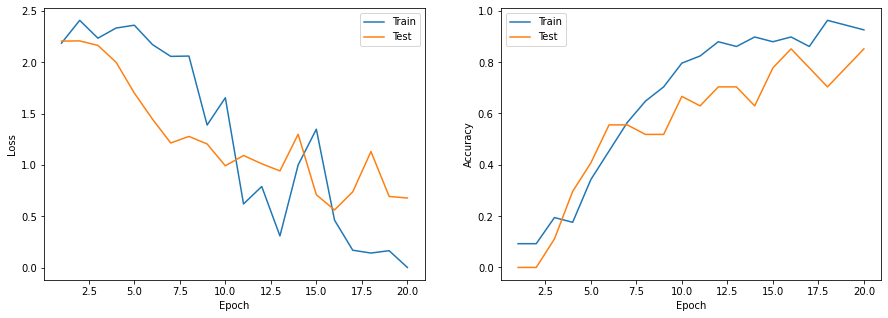

In [17]:
epoch = 20
syn_model = Mel_CNN()
loss_fn = nn.CrossEntropyLoss()
syn_optimizer = torch.optim.Adam(syn_model.parameters(),   lr = 0.0001)
train_dataloader, test_dataloader = prepare_data(syn_mel,syn_tempo)
train_loss, test_loss, train_acc, test_acc= train(syn_model, train_dataloader, test_dataloader, loss_fn, syn_optimizer, epoch)
plot_loss_accuracy(train_loss, test_loss, train_acc, test_acc, epoch)

Simpler Model

Epoch 1
Train Loss for current epoch 2.38836
Train Accuracy for current epoch 0.22
Test Loss for current epoch 0.82214
Test Accuracy for current epoch 0.78
Epoch 2
Train Loss for current epoch 0.00202
Train Accuracy for current epoch 0.88
Test Loss for current epoch 0.56269
Test Accuracy for current epoch 0.78
Epoch 3
Train Loss for current epoch 0.00002
Train Accuracy for current epoch 0.96
Test Loss for current epoch 0.40732
Test Accuracy for current epoch 0.89
Epoch 4
Train Loss for current epoch 0.00003
Train Accuracy for current epoch 0.98
Test Loss for current epoch 0.48890
Test Accuracy for current epoch 0.85
Epoch 5
Train Loss for current epoch 0.00064
Train Accuracy for current epoch 0.97
Test Loss for current epoch 0.56779
Test Accuracy for current epoch 0.85
training is done!


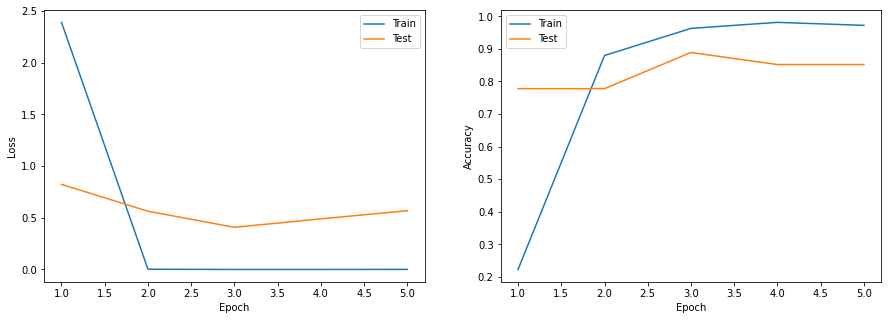

In [20]:
epoch = 5
syn_model = hMel_CNN()
loss_fn = nn.CrossEntropyLoss()
syn_optimizer = torch.optim.Adam(syn_model.parameters(),   lr = 0.0001)
train_dataloader, test_dataloader = prepare_data(syn_mel,syn_tempo)
train_loss, test_loss, train_acc, test_acc= train(syn_model, train_dataloader, test_dataloader, loss_fn, syn_optimizer, epoch)
plot_loss_accuracy(train_loss, test_loss, train_acc, test_acc, epoch)

###Synthetic Augmentation

In [21]:
le = LabelEncoder()
target = le.fit_transform(syn_tempo)

X_train, X_test, y_train, y_test = train_test_split(syn_signal,target, test_size = 0.2)

In [22]:
print(len(X_train))
print(len(y_train))
print(len(X_test))
print(len(y_test))

108
108
27
27


In [23]:
# adding augmented signals to training set and change the pitch 2 semitones down or up for some tracks
def pitch_scale(signal, sr, num_semitones):
    return librosa.effects.pitch_shift(signal, sr, num_semitones)

pitch = random.sample(range(0,len(X_train)),10)
for p in range(len(pitch)):
  augmented_signal = pitch_scale(X_train[p],sr,2)

  X_train.append(augmented_signal)
  y_train = np.append(y_train,y_train[p])


pitch = random.sample(range(0,len(X_train)),10)
for p in range(len(pitch)):
  augmented_signal = pitch_scale(X_train[p],sr,-2)

  X_train.append(augmented_signal)
  y_train = np.append(y_train,y_train[p])

In [24]:
print(len(X_train))
print(len(y_train))
print(len(X_test))
print(len(y_test))

128
128
27
27


In [31]:
syn_mel_trn = []
for i in range(len(X_train)):
  temp = extract_mel_spectogram(X_train[i], 22050, 1024,512)
  syn_mel_trn.append(temp)

syn_mel_trn = np.array(syn_mel_trn)

In [32]:
syn_mel_tst = []
for i in range(len(X_test)):
  temp = extract_mel_spectogram(X_test[i], 22050, 1024,512)
  syn_mel_tst.append(temp)

syn_mel_tst = np.array(syn_mel_tst)

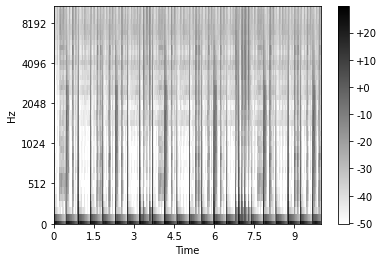

In [33]:
plot_spectogram(syn_mel_trn[0], sr, FRAME_SIZE,HOP_SIZE,'mel')

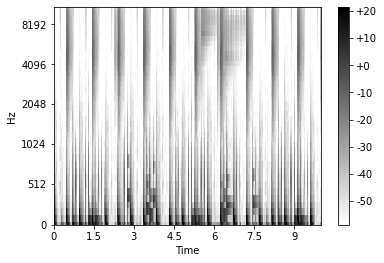

In [34]:
plot_spectogram(syn_mel_tst[0], sr, FRAME_SIZE,HOP_SIZE,'mel')

In [35]:
#train test split before data augmentation

syn_mel_trn = syn_mel_trn.reshape(syn_mel_trn.shape[0],1,syn_mel_trn.shape[1],syn_mel_trn.shape[2])
syn_mel_tst = syn_mel_tst.reshape(syn_mel_tst.shape[0],1,syn_mel_tst.shape[1],syn_mel_tst.shape[2])

b =len(X_test)

tensor_x = torch.Tensor(syn_mel_trn) # transform to torch tensor
tensor_y = torch.Tensor(y_train)
tensor_y = torch.Tensor.long(tensor_y)
my_train_dataset = TensorDataset(tensor_x,tensor_y)
my_train_dataloader = DataLoader(my_train_dataset)

tensor_x = torch.Tensor(syn_mel_tst) # transform to torch tensor
tensor_y = torch.Tensor(y_test)
tensor_y = torch.Tensor.long(tensor_y)
my_test_dataset = TensorDataset(tensor_x,tensor_y)
my_test_dataloader = DataLoader(my_test_dataset,batch_size = b)

Epoch 1
Train Loss for current epoch 2.21426
Train Accuracy for current epoch 0.09
Test Loss for current epoch 2.20712
Test Accuracy for current epoch 0.15
Epoch 2
Train Loss for current epoch 2.19574
Train Accuracy for current epoch 0.09
Test Loss for current epoch 2.20284
Test Accuracy for current epoch 0.15
Epoch 3
Train Loss for current epoch 2.24489
Train Accuracy for current epoch 0.11
Test Loss for current epoch 2.17755
Test Accuracy for current epoch 0.33
Epoch 4
Train Loss for current epoch 2.00740
Train Accuracy for current epoch 0.12
Test Loss for current epoch 2.16244
Test Accuracy for current epoch 0.19
Epoch 5
Train Loss for current epoch 1.96432
Train Accuracy for current epoch 0.13
Test Loss for current epoch 2.16416
Test Accuracy for current epoch 0.33
Epoch 6
Train Loss for current epoch 2.95399
Train Accuracy for current epoch 0.27
Test Loss for current epoch 2.31911
Test Accuracy for current epoch 0.07
Epoch 7
Train Loss for current epoch 1.71295
Train Accuracy for 

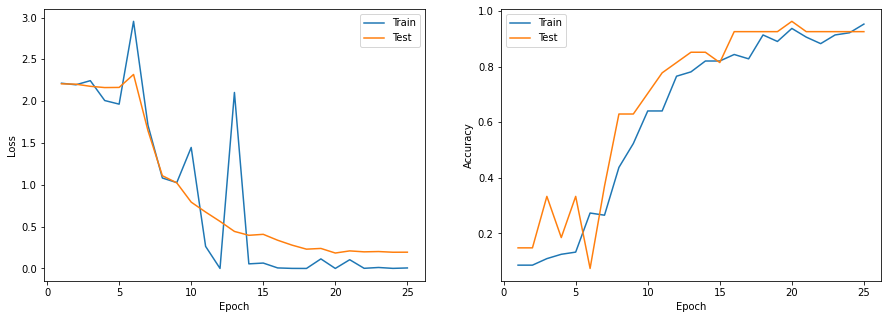

In [56]:
epoch = 25
model = Mel_CNN()
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(),lr = 0.0001)
train_loss, test_loss, train_acc, test_acc= train(model, my_train_dataloader, my_test_dataloader, loss_fn, optimizer, epoch)
plot_loss_accuracy(train_loss, test_loss, train_acc, test_acc, epoch)

Epoch 1
Train Loss for current epoch 1.06494
Train Accuracy for current epoch 0.32
Test Loss for current epoch 0.59824
Test Accuracy for current epoch 0.85
Epoch 2
Train Loss for current epoch 0.00416
Train Accuracy for current epoch 0.91
Test Loss for current epoch 0.32845
Test Accuracy for current epoch 0.96
Epoch 3
Train Loss for current epoch 0.00053
Train Accuracy for current epoch 0.96
Test Loss for current epoch 0.39668
Test Accuracy for current epoch 0.93
Epoch 4
Train Loss for current epoch 0.01691
Train Accuracy for current epoch 1.00
Test Loss for current epoch 0.37110
Test Accuracy for current epoch 0.96
Epoch 5
Train Loss for current epoch 0.00000
Train Accuracy for current epoch 1.00
Test Loss for current epoch 0.47128
Test Accuracy for current epoch 0.96
training is done!


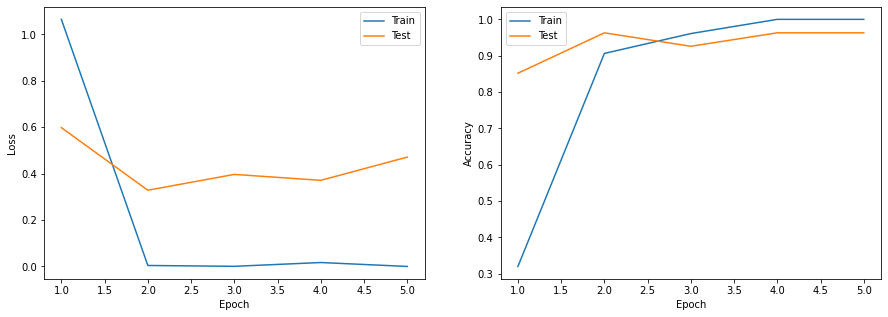

In [38]:
epoch = 5
model = hMel_CNN()
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(),lr = 0.0001)
train_loss, test_loss, train_acc, test_acc= train(model, my_train_dataloader, my_test_dataloader, loss_fn, optimizer, epoch)
plot_loss_accuracy(train_loss, test_loss, train_acc, test_acc, epoch)

In [57]:
#ba 40 ta data augment kheyli zood overfit shod ama ba 20 ta natijaro tunest behtar koneo behtar generalize kone

##AIST++ Dataset

In [10]:
curr_dir = '/content/drive/MyDrive/Colab Notebooks/ML Course Project/AIST/'
%cd "$curr_dir"

/content/drive/MyDrive/Colab Notebooks/ML Course Project/AIST


In [11]:
# original signals
signals = []
for path, subdirs,files in os.walk(curr_dir):
    for file in files:
        signals.append((os.path.join(file)))
len(signals)

60

In [271]:
ipd.Audio(signals[0])

In [12]:
bpm_dict = {
    #music file: bpm
    'mBR0': 80,
    'mBR1': 90,
    'mBR2': 100,
    'mBR3': 110,
    'mBR4': 120,
    'mBR5': 130,
    'mPO0': 80,
    'mPO1': 90,
    'mPO2': 100,
    'mPO3': 110,
    'mPO4': 120,
    'mPO5': 130,
    'mLO0': 80,
    'mLO1': 90,
    'mLO2': 100,
    'mLO3': 110,
    'mLO4': 120,
    'mLO5': 130,
    'mMH0': 80,
    'mMH1': 90,
    'mMH2': 100,
    'mMH3': 110,
    'mMH4': 120,
    'mMH5': 130,
    'mLH0': 80,
    'mLH1': 90,
    'mLH2': 100,
    'mLH3': 110,
    'mLH4': 120,
    'mLH5': 130,
    'mHO0':	110,
    'mHO1':	115,
    'mHO2':	120,
    'mHO3':	125,
    'mHO4':	130,
    'mHO5':	135,
    'mWA0': 80,
    'mWA1': 90,
    'mWA2': 100,
    'mWA3': 110,
    'mWA4': 120,
    'mWA5': 130,
    'mKR0': 80,
    'mKR1': 90,
    'mKR2': 100,
    'mKR3': 110,
    'mKR4': 120,
    'mKR5': 130,
    'mJS0': 80,
    'mJS1': 90,
    'mJS2': 100,
    'mJS3': 110,
    'mJS4': 120,
    'mJS5': 130,
    'mJB0': 80,
    'mJB1': 90,
    'mJB2': 100,
    'mJB3': 110,
    'mJB4': 120,
    'mJB5': 130,
}


In [13]:
aist_tempo_t= []
for trk in signals:
  if trk[0:4] in bpm_dict.keys():
    aist_tempo_t.append(bpm_dict[trk[0:4]])



#### Train on all the sequential 10 second chunks on train set and test on just the arbitrary chosen 10 second of test set

####drop less frequent samples

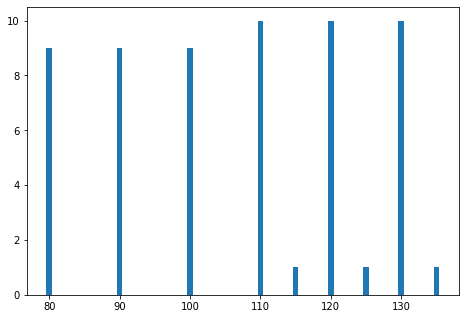

In [15]:
a = [ list(aist_tempo_t).count(80),  list(aist_tempo_t).count(90),  list(aist_tempo_t).count(100),  list(aist_tempo_t).count(110),  list(aist_tempo_t).count(115), 
                list(aist_tempo_t).count(120),  list(aist_tempo_t).count(125),  list(aist_tempo_t).count(130),  list(aist_tempo_t).count(135)]

b = [80,90,100,110,115,120,125,130,135]
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
ax.bar(b,a)
plt.show()

In [16]:
new_x= []
new_y = []
for i in range(len(signals)):
  if aist_tempo_t[i]==115:
    a=0
  elif aist_tempo_t[i]==125:
    a=1
  elif aist_tempo_t[i]==135:
    a=2
  else:
    new_x.append(signals[i])
    new_y.append(aist_tempo_t[i])

In [17]:
len(new_x)

57

In [18]:
len(new_y)

57

In [19]:
le = LabelEncoder()
ntarget = le.fit_transform(new_y)

In [20]:
nx_trn, nx_tst, ny_trn, ny_tst = train_test_split(new_x,ntarget, test_size = 0.3)

In [21]:
naist_signal_trn = []
naist_tempo_trn = []
for i in range(len(nx_trn)):
  audio, sr = librosa.load(nx_trn[i])
  tempo = ny_trn[i]
  buffer = 10 * sr
  samples_total = len(audio)
  samples_wrote = 0	

  for j in range(int(samples_total/buffer)):
    block = audio[samples_wrote : (samples_wrote + buffer)]
    naist_signal_trn.append(block)
    samples_wrote = samples_wrote + 10 * sr
    naist_tempo_trn.append(tempo)

In [22]:
len(naist_signal_trn)

133

In [23]:
def pitch_scale(signal, sr, num_semitones):
    return librosa.effects.pitch_shift(signal, sr, num_semitones)

n = len(nx_trn)
pitch = random.sample(range(0,n),10)
for p in range(len(pitch)):
  yy=pitch_scale(naist_signal_trn[p],sr,2)
  naist_signal_trn.append(yy)
  naist_tempo_trn.append(naist_tempo_trn[p])


pitch = random.sample(range(0,n),10)
for p in range(len(pitch)):
  yy=pitch_scale(naist_signal_trn[p],sr,-2)
  naist_signal_trn.append(yy)
  naist_tempo_trn.append(naist_tempo_trn[p])

In [24]:
len(naist_signal_trn)

153

In [25]:
len(naist_tempo_trn)

153

In [26]:
naist_signal_tst = []

for i in range(len(nx_tst)):
  audio, sr = librosa.load(nx_tst[i])

  buffer = 10 * sr
  samples_total = len(audio)
  samples_wrote = random.randint(0, samples_total-buffer)	
  block = audio[samples_wrote : (samples_wrote + buffer)]

  naist_signal_tst.append(block)

In [27]:
naist_mel_trn = []
for i in range(len(naist_signal_trn)):
  temp = extract_mel_spectogram(naist_signal_trn[i], 22050, 1024,512)
  naist_mel_trn.append(temp)

naist_mel_trn = np.array(naist_mel_trn)

In [28]:
naist_mel_tst = []
for i in range(len(naist_signal_tst)):
  temp = extract_mel_spectogram(naist_signal_tst[i], 22050, 1024,512)
  naist_mel_tst.append(temp)

naist_mel_tst = np.array(naist_mel_tst)

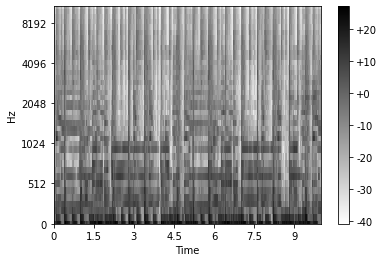

In [29]:
plot_spectogram(naist_mel_trn[2], sr, FRAME_SIZE,HOP_SIZE,'mel')

In [30]:
naist_mel_trn.shape

(153, 40, 431)

In [31]:
naist_mel_tst.shape

(18, 40, 431)

In [32]:
naist_mel_trn = naist_mel_trn.reshape(naist_mel_trn.shape[0],1,naist_mel_trn.shape[1],naist_mel_trn.shape[2])
naist_mel_tst = naist_mel_tst.reshape(naist_mel_tst.shape[0],1,naist_mel_tst.shape[1],naist_mel_tst.shape[2])

b =len(nx_tst)

tensor_x = torch.Tensor(naist_mel_trn) # transform to torch tensor
tensor_y = torch.Tensor(naist_tempo_trn)
tensor_y = torch.Tensor.long(tensor_y)
my_train_dataset = TensorDataset(tensor_x,tensor_y)
my_train_dataloader = DataLoader(my_train_dataset, batch_size = 16, shuffle=True)

tensor_x = torch.Tensor(naist_mel_tst) # transform to torch tensor
tensor_y = torch.Tensor(ny_tst)
tensor_y = torch.Tensor.long(tensor_y)
my_test_dataset = TensorDataset(tensor_x,tensor_y)
my_test_dataloader = DataLoader(my_test_dataset,batch_size = b)

In [37]:
class rMel_CNN(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d( 1, 32 , (3, 5))
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(32, 32, (5, 3))
        self.pool = nn.MaxPool2d(2, 2)
        self.conv3 = nn.Conv2d(32, 32, (3, 3))
        self.pool = nn.MaxPool2d(2, 2)
       
        self.fc1 = nn.Linear(3264, 256)
        # self.fc1 = nn.Linear(119168, 256)
        self.fc2 = nn.Linear(256, 128)
        self.fc3 = nn.Linear(128, 64)
        self.fc4 = nn.Linear(64, 9)
        self.dropout = nn.Dropout(p=0.4)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = self.pool(F.relu(self.conv3(x)))

        x = torch.flatten(x, 1) # flatten all dimensions except batch

        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        x = F.relu(self.fc2(x))
        x = self.dropout(x)
        x = F.relu(self.fc3(x))
        x = self.dropout(x)
        x = self.fc4(x)
        return x

In [39]:
class rhMel_CNN(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d( 1, 32 , (5, 5))
        self.conv2 = nn.Conv2d(32, 32, (3, 3))
        self.pool = nn.MaxPool2d(1, 2)
       
        self.fc1 = nn.Linear(108544, 256)
        self.fc2 = nn.Linear(256, 9)
        self.dropout = nn.Dropout(p=0.5)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = F.relu(self.conv2(x))
     

        x = torch.flatten(x, 1) # flatten all dimensions except batch

        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        x = self.fc2(x)
        return x

Epoch 1
Train Loss for current epoch 3.32587
Train Accuracy for current epoch 0.28
Test Loss for current epoch 4.51234
Test Accuracy for current epoch 0.17
Epoch 2
Train Loss for current epoch 1.15900
Train Accuracy for current epoch 0.41
Test Loss for current epoch 3.82413
Test Accuracy for current epoch 0.11
Epoch 3
Train Loss for current epoch 0.30208
Train Accuracy for current epoch 0.68
Test Loss for current epoch 3.21828
Test Accuracy for current epoch 0.00
Epoch 4
Train Loss for current epoch 0.31871
Train Accuracy for current epoch 0.81
Test Loss for current epoch 3.03084
Test Accuracy for current epoch 0.17
Epoch 5
Train Loss for current epoch 0.31145
Train Accuracy for current epoch 0.94
Test Loss for current epoch 3.48863
Test Accuracy for current epoch 0.17
Epoch 6
Train Loss for current epoch 0.29430
Train Accuracy for current epoch 0.93
Test Loss for current epoch 4.27294
Test Accuracy for current epoch 0.11
Epoch 7
Train Loss for current epoch 0.01885
Train Accuracy for 

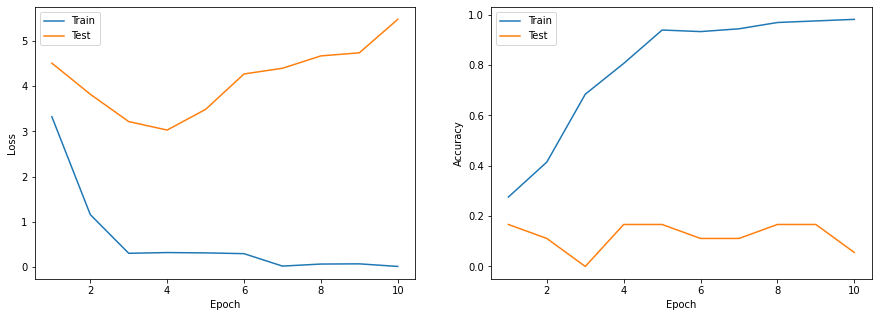

In [40]:
epoch = 10
model = rhMel_CNN()
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(),lr = 0.0001)

train_loss, test_loss, train_acc, test_acc= train(model, my_train_dataloader, my_test_dataloader, loss_fn, optimizer, epoch)
plot_loss_accuracy(train_loss, test_loss, train_acc, test_acc, epoch)

Epoch 1
Train Loss for current epoch 2.14791
Train Accuracy for current epoch 0.13
Test Loss for current epoch 2.02150
Test Accuracy for current epoch 0.22
Epoch 2
Train Loss for current epoch 2.01045
Train Accuracy for current epoch 0.18
Test Loss for current epoch 1.98933
Test Accuracy for current epoch 0.17
Epoch 3
Train Loss for current epoch 2.08554
Train Accuracy for current epoch 0.18
Test Loss for current epoch 1.94372
Test Accuracy for current epoch 0.06
Epoch 4
Train Loss for current epoch 2.24276
Train Accuracy for current epoch 0.24
Test Loss for current epoch 1.93856
Test Accuracy for current epoch 0.06
Epoch 5
Train Loss for current epoch 2.26750
Train Accuracy for current epoch 0.16
Test Loss for current epoch 1.97392
Test Accuracy for current epoch 0.06
Epoch 6
Train Loss for current epoch 2.01512
Train Accuracy for current epoch 0.18
Test Loss for current epoch 1.97100
Test Accuracy for current epoch 0.06
Epoch 7
Train Loss for current epoch 1.91313
Train Accuracy for 

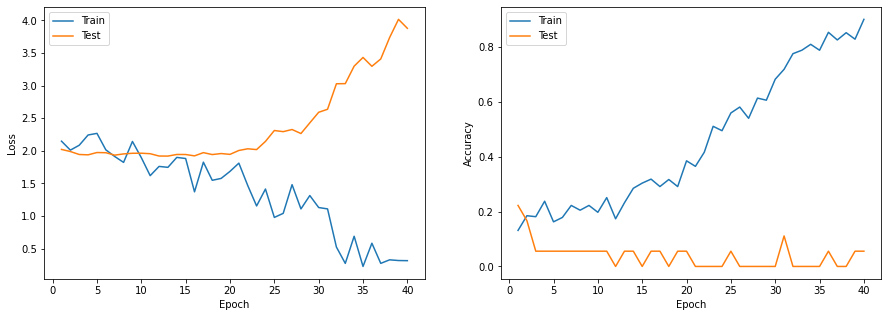

In [42]:
epoch = 40
model = rMel_CNN()
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(),lr = 0.0001)

train_loss, test_loss, train_acc, test_acc= train(model, my_train_dataloader, my_test_dataloader, loss_fn, optimizer, epoch)
plot_loss_accuracy(train_loss, test_loss, train_acc, test_acc, epoch)

####Before droping the less frequent samples

In [275]:
le = LabelEncoder()
target = le.fit_transform(aist_tempo_t)

In [367]:
x_trn, x_tst, y_trn, y_tst = train_test_split(signals,target, test_size = 0.3)

In [370]:
aist_signal_trn = []
aist_tempo_trn = []
for i in range(len(x_trn)):
  audio, sr = librosa.load(x_trn[i])
  tempo = y_trn[i]
  buffer = 10 * sr
  samples_total = len(audio)
  samples_wrote = 0	

  for j in range(int(samples_total/buffer)):
    block = audio[samples_wrote : (samples_wrote + buffer)]
    aist_signal_trn.append(block)
    samples_wrote = samples_wrote + 10 * sr
    aist_tempo_trn.append(tempo)
 

In [373]:
aist_signal_tst = []

for i in range(len(x_tst)):
  audio, sr = librosa.load(x_tst[i])

  buffer = 10 * sr
  samples_total = len(audio)
  samples_wrote = random.randint(0, samples_total-buffer)	
  block = audio[samples_wrote : (samples_wrote + buffer)]

  aist_signal_tst.append(block)

In [375]:
aist_mel_trn = []
for i in range(len(aist_signal_trn)):
  temp = extract_mel_spectogram(aist_signal_trn[i], 22050, 1024,512)
  aist_mel_trn.append(temp)

aist_mel_trn = np.array(aist_mel_trn)

In [377]:
aist_mel_tst = []
for i in range(len(aist_signal_tst)):
  temp = extract_mel_spectogram(aist_signal_tst[i], 22050, 1024,512)
  aist_mel_tst.append(temp)

aist_mel_tst = np.array(aist_mel_tst)

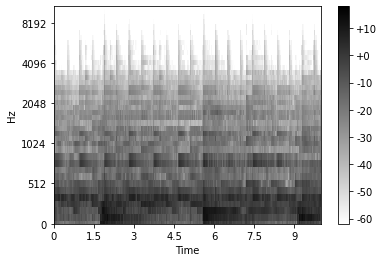

In [379]:
plot_spectogram(aist_mel_tst[1], sr, FRAME_SIZE,HOP_SIZE,'mel')

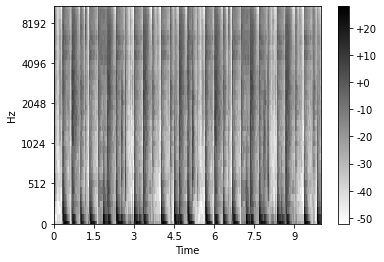

In [380]:
plot_spectogram(aist_mel_trn[5], sr, FRAME_SIZE,HOP_SIZE,'mel')

In [381]:
aist_mel_trn = aist_mel_trn.reshape(aist_mel_trn.shape[0],1,aist_mel_trn.shape[1],aist_mel_trn.shape[2])
aist_mel_tst = aist_mel_tst.reshape(aist_mel_tst.shape[0],1,aist_mel_tst.shape[1],aist_mel_tst.shape[2])

b =len(x_tst)

tensor_x = torch.Tensor(aist_mel_trn) # transform to torch tensor
tensor_y = torch.Tensor(aist_tempo_trn)
tensor_y = torch.Tensor.long(tensor_y)
my_train_dataset = TensorDataset(tensor_x,tensor_y)
my_train_dataloader = DataLoader(my_train_dataset,batch_size = 10)

tensor_x = torch.Tensor(aist_mel_tst) # transform to torch tensor
tensor_y = torch.Tensor(y_tst)
tensor_y = torch.Tensor.long(tensor_y)
my_test_dataset = TensorDataset(tensor_x,tensor_y)
my_test_dataloader = DataLoader(my_test_dataset,batch_size = b)

Epoch 1
Train Loss for current epoch 2.98859
Train Accuracy for current epoch 0.05
Test Loss for current epoch 3.02171
Test Accuracy for current epoch 0.28
Epoch 2
Train Loss for current epoch 2.74605
Train Accuracy for current epoch 0.07
Test Loss for current epoch 2.71781
Test Accuracy for current epoch 0.28
Epoch 3
Train Loss for current epoch 2.87376
Train Accuracy for current epoch 0.10
Test Loss for current epoch 2.64510
Test Accuracy for current epoch 0.11
Epoch 4
Train Loss for current epoch 2.20970
Train Accuracy for current epoch 0.13
Test Loss for current epoch 2.51980
Test Accuracy for current epoch 0.06
Epoch 5
Train Loss for current epoch 2.66386
Train Accuracy for current epoch 0.10
Test Loss for current epoch 2.53475
Test Accuracy for current epoch 0.06
Epoch 6
Train Loss for current epoch 2.53715
Train Accuracy for current epoch 0.13
Test Loss for current epoch 2.34321
Test Accuracy for current epoch 0.06
Epoch 7
Train Loss for current epoch 2.13830
Train Accuracy for 

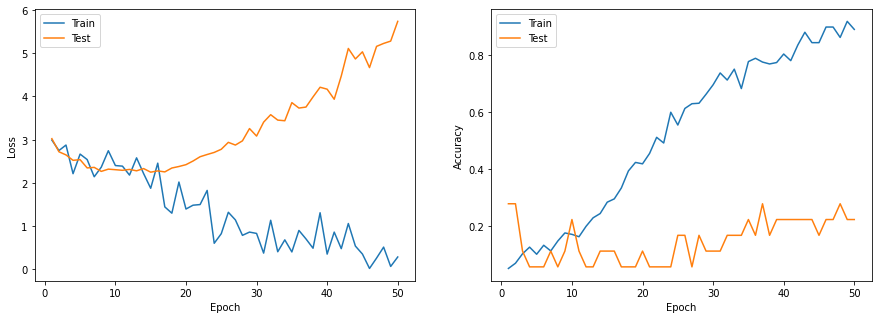

In [387]:
epoch = 50
model = Mel_CNN()
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(),lr = 0.0001)

train_loss, test_loss, train_acc, test_acc= train(model, my_train_dataloader, my_test_dataloader, loss_fn, optimizer, epoch)
plot_loss_accuracy(train_loss, test_loss, train_acc, test_acc, epoch)

In [388]:
# when learning rate is 0.0001 the model is trained but it got overfitt but when the learning rate is 0.00001 the learning speed is veeeery slow but the test loss is decreasing

In [251]:
#if we use the syn_model and continue trainig with AIST++ the model will be overfitted very soon

###Extract the different chunks of songs and their spectograms

In [137]:
aist_signal_ar10 = []

for i in range(len(signals)):
  audio, sr = librosa.load(signals[i])

  buffer = 10 * sr
  samples_total = len(audio)
  samples_wrote = random.randint(0, samples_total-buffer)	
  block = audio[samples_wrote : (samples_wrote + buffer)]

  aist_signal_ar10.append(block)
 

In [138]:
len(aist_signal_ar10)

60

In [14]:
aist_signal_f10 = []

for i in range(len(signals)):
  audio, sr = librosa.load(signals[i])

  buffer = 10 * sr
  samples_total = len(audio)
  samples_wrote = 0
  block = audio[samples_wrote : (samples_wrote + buffer)]

  aist_signal_f10.append(block)

In [133]:
len(aist_signal_f10)

60

In [134]:
aist_mel_f = []
for i in range(len(aist_signal_f10)):
  temp = extract_mel_spectogram(aist_signal_f10[i], 22050, 1024,512)
  aist_mel_f.append(temp)

aist_mel_f = np.array(aist_mel_f)

In [139]:
aist_mel_arb = []
for i in range(len(aist_signal_ar10)):
  temp = extract_mel_spectogram(aist_signal_ar10[i], 22050, 1024,512)
  aist_mel_arb.append(temp)

aist_mel_arb = np.array(aist_mel_arb)

####Model on the first 10-second of songs

Epoch 1
Train Loss for current epoch 2.30524
Train Accuracy for current epoch 0.08
Test Loss for current epoch 2.19996
Test Accuracy for current epoch 0.00
Epoch 2
Train Loss for current epoch 2.37746
Train Accuracy for current epoch 0.15
Test Loss for current epoch 2.19247
Test Accuracy for current epoch 0.00
Epoch 3
Train Loss for current epoch 2.29386
Train Accuracy for current epoch 0.15
Test Loss for current epoch 2.17034
Test Accuracy for current epoch 0.00
Epoch 4
Train Loss for current epoch 2.25727
Train Accuracy for current epoch 0.25
Test Loss for current epoch 2.18087
Test Accuracy for current epoch 0.00
Epoch 5
Train Loss for current epoch 2.04785
Train Accuracy for current epoch 0.19
Test Loss for current epoch 2.12681
Test Accuracy for current epoch 0.00
Epoch 6
Train Loss for current epoch 2.14390
Train Accuracy for current epoch 0.31
Test Loss for current epoch 2.09881
Test Accuracy for current epoch 0.17
Epoch 7
Train Loss for current epoch 2.01041
Train Accuracy for 

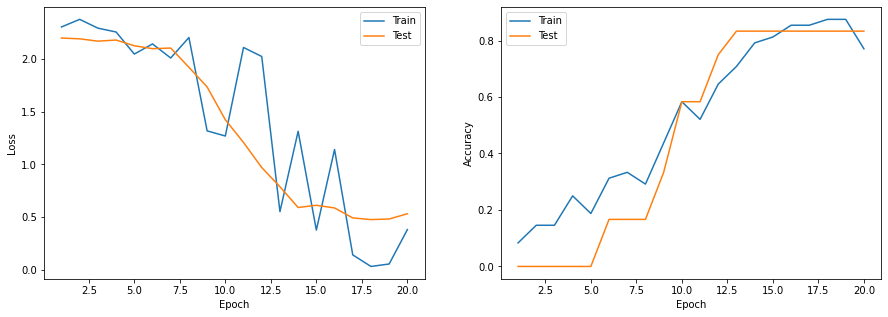

In [100]:
epoch = 20
model = Mel_CNN()
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(),lr = 0.0001)
train_dataloader, test_dataloader = prepare_data(aist_mel_f,aist_tempo_t)
train_loss, test_loss, train_acc, test_acc= train(model, train_dataloader, test_dataloader, loss_fn, optimizer, epoch)
plot_loss_accuracy(train_loss, test_loss, train_acc, test_acc, epoch)

Epoch 1
Train Loss for current epoch 2.54135
Train Accuracy for current epoch 0.12
Test Loss for current epoch 2.05254
Test Accuracy for current epoch 0.17
Epoch 2
Train Loss for current epoch 2.50488
Train Accuracy for current epoch 0.08
Test Loss for current epoch 2.04912
Test Accuracy for current epoch 0.17
Epoch 3
Train Loss for current epoch 2.24768
Train Accuracy for current epoch 0.08
Test Loss for current epoch 2.03309
Test Accuracy for current epoch 0.17
Epoch 4
Train Loss for current epoch 2.24040
Train Accuracy for current epoch 0.15
Test Loss for current epoch 2.00348
Test Accuracy for current epoch 0.17
Epoch 5
Train Loss for current epoch 2.28582
Train Accuracy for current epoch 0.12
Test Loss for current epoch 2.00143
Test Accuracy for current epoch 0.17
Epoch 6
Train Loss for current epoch 2.16033
Train Accuracy for current epoch 0.15
Test Loss for current epoch 1.96212
Test Accuracy for current epoch 0.17
Epoch 7
Train Loss for current epoch 1.78843
Train Accuracy for 

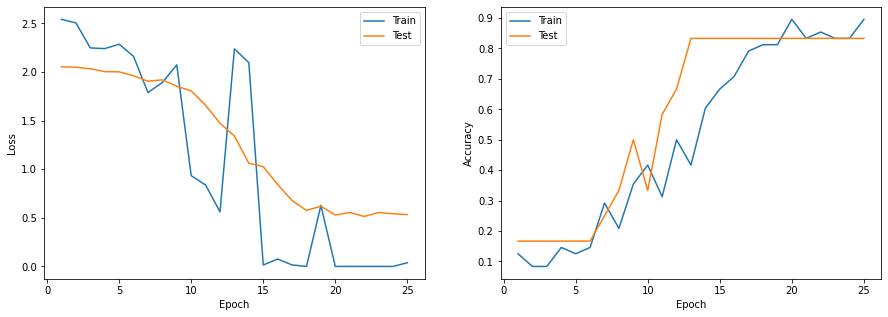

In [72]:
epoch = 25
model = Mel_CNN()
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(),lr = 0.0001)
train_dataloader, test_dataloader = prepare_data(aist_mel_f,aist_tempo_t)
train_loss, test_loss, train_acc, test_acc= train(model, train_dataloader, test_dataloader, loss_fn, optimizer, epoch)
plot_loss_accuracy(train_loss, test_loss, train_acc, test_acc, epoch)

Epoch 1
Train Loss for current epoch 5.86558
Train Accuracy for current epoch 0.12
Test Loss for current epoch 1.30760
Test Accuracy for current epoch 0.58
Epoch 2
Train Loss for current epoch 2.13004
Train Accuracy for current epoch 0.71
Test Loss for current epoch 0.54488
Test Accuracy for current epoch 0.92
Epoch 3
Train Loss for current epoch 0.02860
Train Accuracy for current epoch 0.96
Test Loss for current epoch 0.48483
Test Accuracy for current epoch 0.92
Epoch 4
Train Loss for current epoch 0.01282
Train Accuracy for current epoch 1.00
Test Loss for current epoch 0.40111
Test Accuracy for current epoch 0.92
Epoch 5
Train Loss for current epoch 0.03579
Train Accuracy for current epoch 1.00
Test Loss for current epoch 0.69932
Test Accuracy for current epoch 0.92
training is done!


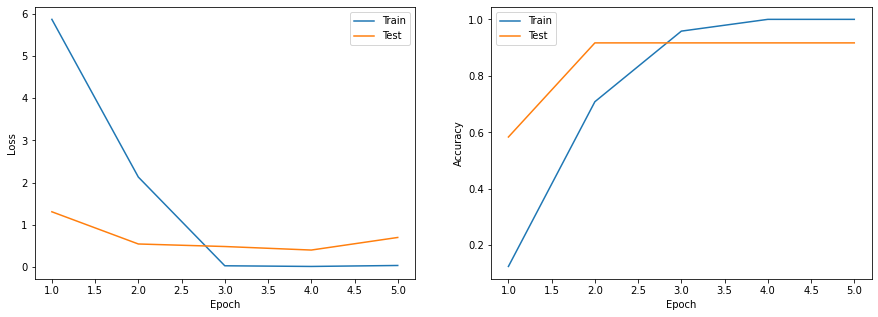

In [138]:
epoch = 5
model = hMel_CNN()
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(),lr = 0.0001)
train_dataloader, test_dataloader = prepare_data(aist_mel_f,aist_tempo_t)
train_loss, test_loss, train_acc, test_acc= train(model, train_dataloader, test_dataloader, loss_fn, optimizer, epoch)
plot_loss_accuracy(train_loss, test_loss, train_acc, test_acc, epoch)

#### Model on arbitrary chosen 10 second of songs

Epoch 1
Train Loss for current epoch 2.72100
Train Accuracy for current epoch 0.10
Test Loss for current epoch 2.38592
Test Accuracy for current epoch 0.17
Epoch 2
Train Loss for current epoch 2.52082
Train Accuracy for current epoch 0.25
Test Loss for current epoch 2.55874
Test Accuracy for current epoch 0.17
Epoch 3
Train Loss for current epoch 1.59910
Train Accuracy for current epoch 0.27
Test Loss for current epoch 2.64508
Test Accuracy for current epoch 0.25
Epoch 4
Train Loss for current epoch 1.68694
Train Accuracy for current epoch 0.44
Test Loss for current epoch 2.66100
Test Accuracy for current epoch 0.08
Epoch 5
Train Loss for current epoch 0.84031
Train Accuracy for current epoch 0.56
Test Loss for current epoch 2.52803
Test Accuracy for current epoch 0.08
Epoch 6
Train Loss for current epoch 1.13240
Train Accuracy for current epoch 0.69
Test Loss for current epoch 2.30519
Test Accuracy for current epoch 0.25
Epoch 7
Train Loss for current epoch 0.87246
Train Accuracy for 

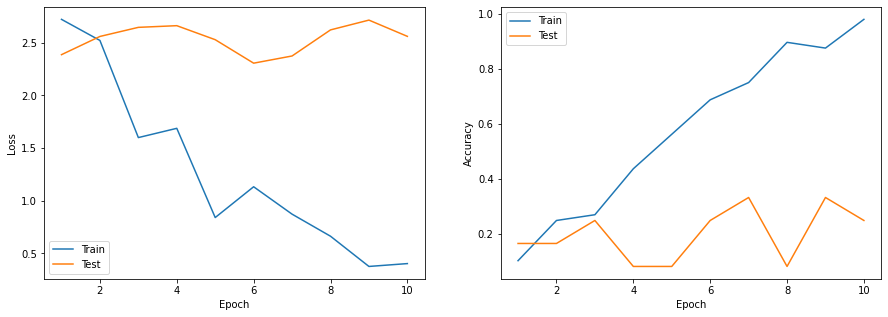

In [149]:
epoch = 10
model = hMel_CNN()
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(),lr = 0.000005)
train_dataloader, test_dataloader = prepare_data(aist_mel_arb,aist_tempo_t)
train_loss, test_loss, train_acc, test_acc= train(model, train_dataloader, test_dataloader, loss_fn, optimizer, epoch)
plot_loss_accuracy(train_loss, test_loss, train_acc, test_acc, epoch)

Epoch 1
Train Loss for current epoch 1.85593
Train Accuracy for current epoch 0.08
Test Loss for current epoch 2.18612
Test Accuracy for current epoch 0.08
Epoch 2
Train Loss for current epoch 2.14779
Train Accuracy for current epoch 0.12
Test Loss for current epoch 2.14922
Test Accuracy for current epoch 0.08
Epoch 3
Train Loss for current epoch 1.81198
Train Accuracy for current epoch 0.17
Test Loss for current epoch 2.15119
Test Accuracy for current epoch 0.08
Epoch 4
Train Loss for current epoch 1.80840
Train Accuracy for current epoch 0.15
Test Loss for current epoch 2.11851
Test Accuracy for current epoch 0.08
Epoch 5
Train Loss for current epoch 1.54046
Train Accuracy for current epoch 0.19
Test Loss for current epoch 2.09782
Test Accuracy for current epoch 0.08
Epoch 6
Train Loss for current epoch 2.34875
Train Accuracy for current epoch 0.27
Test Loss for current epoch 2.12205
Test Accuracy for current epoch 0.08
Epoch 7
Train Loss for current epoch 1.83411
Train Accuracy for 

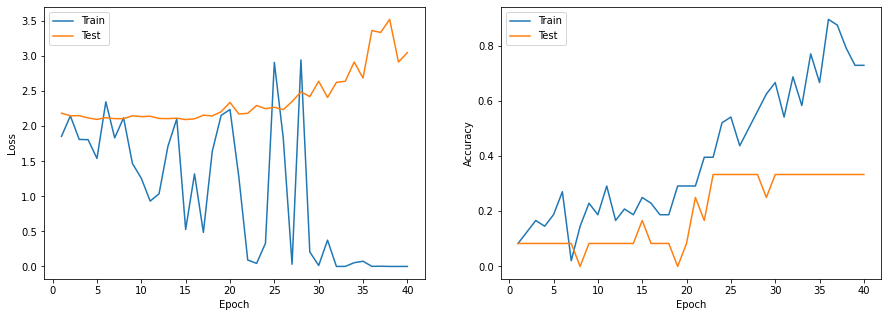

In [104]:
epoch = 40
model = Mel_CNN()
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(),lr = 0.0001)
train_dataloader, test_dataloader = prepare_data(aist_mel_arb,aist_tempo_t)
train_loss, test_loss, train_acc, test_acc= train(model, train_dataloader, test_dataloader, loss_fn, optimizer, epoch)
plot_loss_accuracy(train_loss, test_loss, train_acc, test_acc, epoch)

## Music Dataset

In [40]:
bpm_dic = dict()
curr_dir = '/content/drive/MyDrive/Colab Notebooks/ML Course Project/ballroomGroundTruth/'
for path, subdirs,files in os.walk(curr_dir):
  for file in files:
    f = open(curr_dir+file,"rb")
    a = f.read()
    f.close()
    temp = a[0:3].decode("utf-8") 
    bpm_dic[file[:-4]] = int(temp)





In [41]:
len(bpm_dic.values())

698

In [42]:
curr_dir = '/content/drive/MyDrive/Colab Notebooks/ML Course Project/Music/'
music_signal = []
music_tempo = []
for path, subdirs,files in os.walk(curr_dir):
  for file in files:
    yy,sr = librosa.load(curr_dir+file)
    music_signal.append(yy) 
    
    music_tempo.append(bpm_dic[file[:-4]])


In [43]:
for i in range(len(music_tempo)):
  music_tempo[i] = (int(music_tempo[i]/5) * 5)

In [44]:
le = LabelEncoder()
target = le.fit_transform(music_tempo)

In [45]:
nx_trn, nx_tst, ny_trn, ny_tst = train_test_split(music_signal,target, test_size = 0.2)

In [47]:
def extract_mel_spectogram(Y, sr, frame_size):
  mel_spectrogram = librosa.feature.melspectrogram(Y, sr=sr, n_fft=frame_size, hop_length=441, n_mels=81)
  log_mel_spectrogram = librosa.power_to_db(mel_spectrogram)

  return log_mel_spectrogram


In [52]:
music_signal_trn = []
music_tempo_trn = []
for i in range(len(nx_trn)):
  audio=nx_trn[i]
  tempo = ny_trn[i]
  buffer = 20 * sr
  samples_wrote = 0	

  block = audio[samples_wrote : (samples_wrote + buffer)]
  music_signal_trn.append(block)
  music_tempo_trn.append(tempo)

 
music_signal_tst = []
music_tempo_tst = []
for i in range(len(nx_tst)):
  audio=nx_tst[i]
  tempo = ny_tst[i]
  buffer = 20 * sr
  samples_wrote = 0	
  block = audio[samples_wrote : (samples_wrote + buffer)]
  music_signal_tst.append(block)
  music_tempo_tst.append(tempo)


In [53]:
music_mel_trn= []
for i in range(len(music_signal_trn)):
  temp = extract_mel_spectogram(music_signal_trn[i], 44100, 2048)
  music_mel_trn.append(temp)
  # print(temp.shape)
music_mel_trn = np.array(music_mel_trn)

In [54]:
music_mel_tst= []
for i in range(len(music_signal_tst)):
  temp = extract_mel_spectogram(music_signal_tst[i],  44100, 2048)
  music_mel_tst.append(temp)
music_mel_tst = np.array(music_mel_tst)

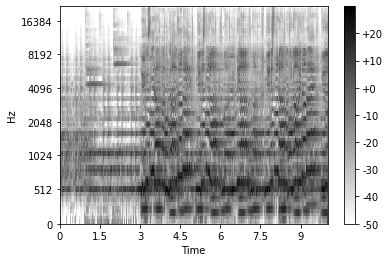

In [55]:
plot_spectogram(music_mel_trn[0], 44100, 2048,441,'mel')

###TCN Model:
Convolution part

In [56]:
class CNN_TCN(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d( 1, 16 , (3, 3))
        self.conv2 = nn.Conv2d(16, 16, (3, 3))
        self.conv3 = nn.Conv2d(16, 16, (1, 8))
        self.pool = nn.MaxPool2d(1, 3)
       
        self.fc1 = nn.Linear(12208, 28)
      
        self.dropout2d = nn.Dropout2d(p=0.1)
      

    def forward(self, x):
        x = self.pool(F.elu(self.conv1(x)))
        x = self.dropout2d(x)
        x = self.pool(F.elu(self.conv2(x)))
        x = self.dropout2d(x)
        x = F.elu(self.conv2(x))
     

        x = torch.flatten(x, 1) # flatten all dimensions except batch

        x =self.fc1(x)
     
        return x

In [57]:
music_mel_trn = music_mel_trn.reshape(music_mel_trn.shape[0],1,music_mel_trn.shape[1],music_mel_trn.shape[2])
music_mel_tst = music_mel_tst.reshape(music_mel_tst.shape[0],1,music_mel_tst.shape[1],music_mel_tst.shape[2])

b =len(music_mel_tst)

tensor_x = torch.Tensor(music_mel_trn) # transform to torch tensor
tensor_y = torch.Tensor(music_tempo_trn)
tensor_y = torch.Tensor.long(tensor_y)
my_train_dataset = TensorDataset(tensor_x,tensor_y)
my_train_dataloader = DataLoader(my_train_dataset,batch_size = 1)

tensor_x = torch.Tensor(music_mel_tst) # transform to torch tensor
tensor_y = torch.Tensor(music_tempo_tst)
tensor_y = torch.Tensor.long(tensor_y)
my_test_dataset = TensorDataset(tensor_x,tensor_y)
my_test_dataloader = DataLoader(my_test_dataset,batch_size = b)

Epoch 1
Train Loss for current epoch 1.97400
Train Accuracy for current epoch 0.15
Test Loss for current epoch 2.67730
Test Accuracy for current epoch 0.22
Epoch 2
Train Loss for current epoch 1.94762
Train Accuracy for current epoch 0.23
Test Loss for current epoch 2.60847
Test Accuracy for current epoch 0.25
Epoch 3
Train Loss for current epoch 1.89566
Train Accuracy for current epoch 0.32
Test Loss for current epoch 2.54250
Test Accuracy for current epoch 0.28
Epoch 4
Train Loss for current epoch 1.70217
Train Accuracy for current epoch 0.39
Test Loss for current epoch 2.50372
Test Accuracy for current epoch 0.30
Epoch 5
Train Loss for current epoch 1.54021
Train Accuracy for current epoch 0.42
Test Loss for current epoch 2.47851
Test Accuracy for current epoch 0.29
Epoch 6
Train Loss for current epoch 1.25516
Train Accuracy for current epoch 0.52
Test Loss for current epoch 2.45385
Test Accuracy for current epoch 0.29
Epoch 7
Train Loss for current epoch 0.95687
Train Accuracy for 

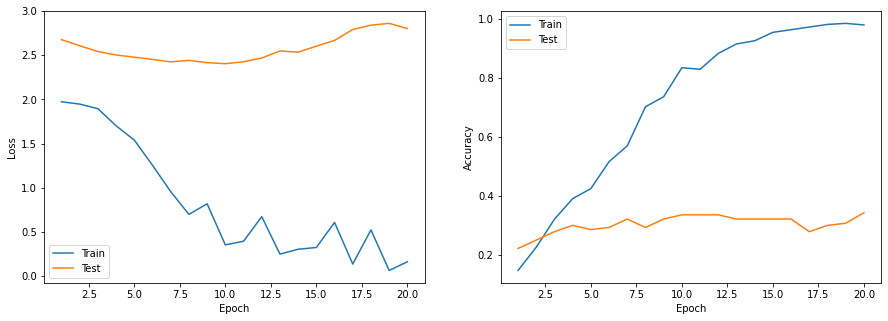

In [58]:
epoch = 20
model = CNN_TCN()
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(),   lr = 0.00001)

train_loss, test_loss, train_acc, test_acc= train(model, my_train_dataloader, my_test_dataloader, loss_fn, optimizer, epoch)
plot_loss_accuracy(train_loss, test_loss, train_acc, test_acc, epoch)

###Original Model:

In [63]:
class mMel_CNN(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d( 1, 32 , (3, 5))
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(32, 32, (5, 3))
        self.pool = nn.MaxPool2d(2, 2)
        self.conv3 = nn.Conv2d(32, 32, (3, 3))
        self.pool = nn.MaxPool2d(2, 2)
       
        self.fc1 = nn.Linear(6720, 1024)
        self.fc2 = nn.Linear(1024, 512)
        self.fc3 = nn.Linear(512, 256)
        self.fc4 = nn.Linear(256, 128)
        self.fc5 = nn.Linear(128, 64)
        self.fc6 = nn.Linear(64, 28)
        self.dropout = nn.Dropout(p=0.4)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = self.pool(F.relu(self.conv3(x)))

        x = torch.flatten(x, 1) # flatten all dimensions except batch

        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        x = F.relu(self.fc2(x))
        x = self.dropout(x)
        x = F.relu(self.fc3(x))
        x = self.dropout(x)
        x = F.relu(self.fc4(x))
        x = self.dropout(x)
        x = F.relu(self.fc5(x))
        x = self.dropout(x)
        x = F.relu(self.fc6(x))
        return x

Epoch 1
Train Loss for current epoch 3.27724
Train Accuracy for current epoch 0.11
Test Loss for current epoch 3.02807
Test Accuracy for current epoch 0.20
Epoch 2
Train Loss for current epoch 3.12606
Train Accuracy for current epoch 0.16
Test Loss for current epoch 2.96472
Test Accuracy for current epoch 0.16
Epoch 3
Train Loss for current epoch 3.53586
Train Accuracy for current epoch 0.12
Test Loss for current epoch 2.98351
Test Accuracy for current epoch 0.20
Epoch 4
Train Loss for current epoch 2.96508
Train Accuracy for current epoch 0.16
Test Loss for current epoch 2.94140
Test Accuracy for current epoch 0.20
Epoch 5
Train Loss for current epoch 3.40885
Train Accuracy for current epoch 0.15
Test Loss for current epoch 2.90990
Test Accuracy for current epoch 0.20
Epoch 6
Train Loss for current epoch 3.11150
Train Accuracy for current epoch 0.16
Test Loss for current epoch 2.89987
Test Accuracy for current epoch 0.20
Epoch 7
Train Loss for current epoch 3.04262
Train Accuracy for 

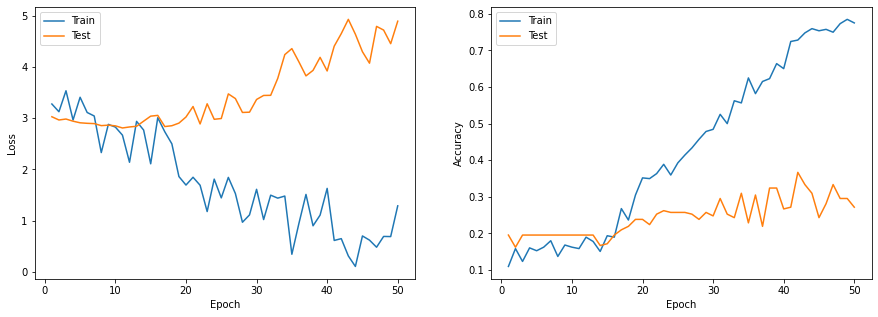

In [181]:
epoch = 50
model = mMel_CNN()
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(),   lr = 0.001)

train_loss, test_loss, train_acc, test_acc= train(model, my_train_dataloader, my_test_dataloader, loss_fn, optimizer, epoch)
plot_loss_accuracy(train_loss, test_loss, train_acc, test_acc, epoch)

###Feed Forward Model Failed!

In [108]:
def features_extractor(signal):
    mfccs_features = librosa.feature.mfcc(y=signal, sr=22050*2, n_mfcc=40)
    mfccs_scaled_features = np.mean(mfccs_features.T,axis=0)
    
    return mfccs_scaled_features
    

In [109]:
music_inp = []
for i in range(len(music_signal)):
  music_inp.append(features_extractor(music_signal[i]))


music_inp = np.array(music_inp)

In [110]:
len(music_inp)

698

In [111]:
music_inp.shape

(698, 40)

In [112]:
music_tempo.shape

(698,)

In [85]:
class Mel_FF(nn.Module):
    def __init__(self):
        super().__init__()
        self.fc1 = nn.Linear(40 , 100)
        self.fc2 = nn.Linear(100, 300)
        self.fc3 = nn.Linear(300, 250)
        self.fc4 = nn.Linear(250, 200)
        self.fc5 = nn.Linear(200, 28)
        self.dropout = nn.Dropout(p=0.3)

    def forward(self, x):

        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        x = F.relu(self.fc2(x))
        x = self.dropout(x)
        x = F.relu(self.fc3(x))
        x = self.dropout(x)
        x = F.relu(self.fc4(x))
        x = self.dropout(x)
        x = F.relu(self.fc5(x))
        return x

In [113]:
le = LabelEncoder()
target = le.fit_transform(music_tempo)
X_train, X_test, y_train, y_test = train_test_split(music_inp,target, test_size = 0.2)

b = X_test.shape[0]
tensor_x = torch.Tensor(X_train) # transform to torch tensor
tensor_y = torch.Tensor(y_train)
tensor_y = torch.Tensor.long(tensor_y)
my_train_dataset = TensorDataset(tensor_x,tensor_y)
my_train_dataloader = DataLoader(my_train_dataset,batch_size = 16, shuffle=True)

tensor_x = torch.Tensor(X_test) # transform to torch tensor
tensor_y = torch.Tensor(y_test)
tensor_y = torch.Tensor.long(tensor_y)
my_test_dataset = TensorDataset(tensor_x,tensor_y)
my_test_dataloader = DataLoader(my_test_dataset,batch_size = b)

Epoch 1
Train Loss for current epoch 2.69196
Train Accuracy for current epoch 0.13
Test Loss for current epoch 2.85896
Test Accuracy for current epoch 0.19
Epoch 2
Train Loss for current epoch 3.01407
Train Accuracy for current epoch 0.16
Test Loss for current epoch 2.87713
Test Accuracy for current epoch 0.17
Epoch 3
Train Loss for current epoch 2.81297
Train Accuracy for current epoch 0.18
Test Loss for current epoch 2.86695
Test Accuracy for current epoch 0.17
Epoch 4
Train Loss for current epoch 3.54413
Train Accuracy for current epoch 0.17
Test Loss for current epoch 2.75447
Test Accuracy for current epoch 0.26
Epoch 5
Train Loss for current epoch 3.00184
Train Accuracy for current epoch 0.19
Test Loss for current epoch 2.75823
Test Accuracy for current epoch 0.23
Epoch 6
Train Loss for current epoch 2.13962
Train Accuracy for current epoch 0.20
Test Loss for current epoch 2.70966
Test Accuracy for current epoch 0.19
Epoch 7
Train Loss for current epoch 2.82223
Train Accuracy for 

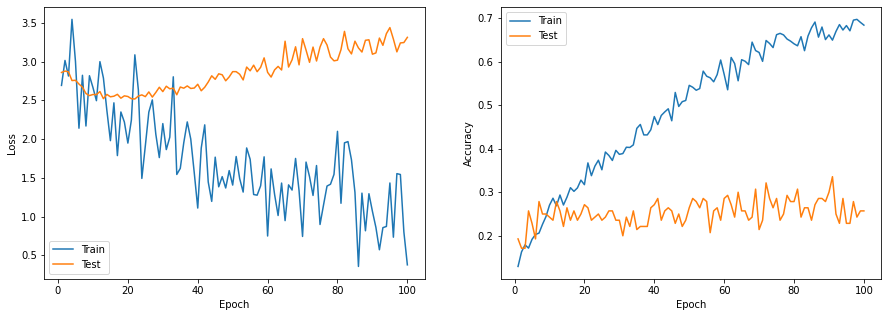

In [119]:
epoch = 100
model = Mel_FF()
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(),   lr = 0.001)

train_loss, test_loss, train_acc, test_acc= train(model, my_train_dataloader, my_test_dataloader, loss_fn, optimizer, epoch)
plot_loss_accuracy(train_loss, test_loss, train_acc, test_acc, epoch)

#NEXT STEPS: